CONFIG

In [ ]:
USE_GPU = True
MIN_CONF = 0.3
NMS_THRESH = 0.3

DETECTION

In [ ]:
import numpy as np
import cv2


def detect_people(frame, net, ln, personId=0):
	(H, W) = frame.shape[:2]
	results = []

	blob = cv2.dnn.blobFromImage(frame, 1 / 255.0, (416, 416), swapRB=True, crop=False)
	net.setInput(blob)
	layerOutputs = net.forward(ln)

	boxes = []
	centroids = []
	confidences = []

	for output in layerOutputs:
		for detection in output:
			scores = detection[5:]
			classID = np.argmax(scores)
			confidence = scores[classID]

			if classID == personId and confidence > MIN_CONF:
				box = detection[0:4] * np.array([W, H, W, H])
				(X_center, Y_center, width, height) = box.astype("int")

				x = int(X_center - (width / 2))
				y = int(Y_center - (height / 2))

				boxes.append([x, y, int(width), int(height)])
				centroids.append((X_center, Y_center))
				confidences.append(float(confidence))

	id = cv2.dnn.NMSBoxes(boxes, confidences, MIN_CONF, NMS_THRESH)

	if len(id) > 0:
		for i in id.flatten():
			(x, y) = (boxes[i][0], boxes[i][1])
			(w, h) = (boxes[i][2], boxes[i][3])

			r = (confidences[i], (x, y, x + w, y + h), centroids[i])
			results.append(r)

	return results

Searching for GPU


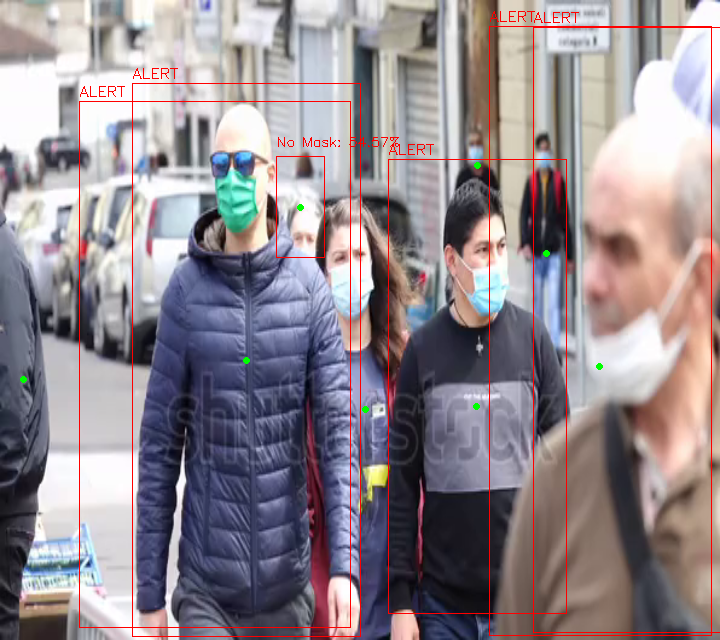

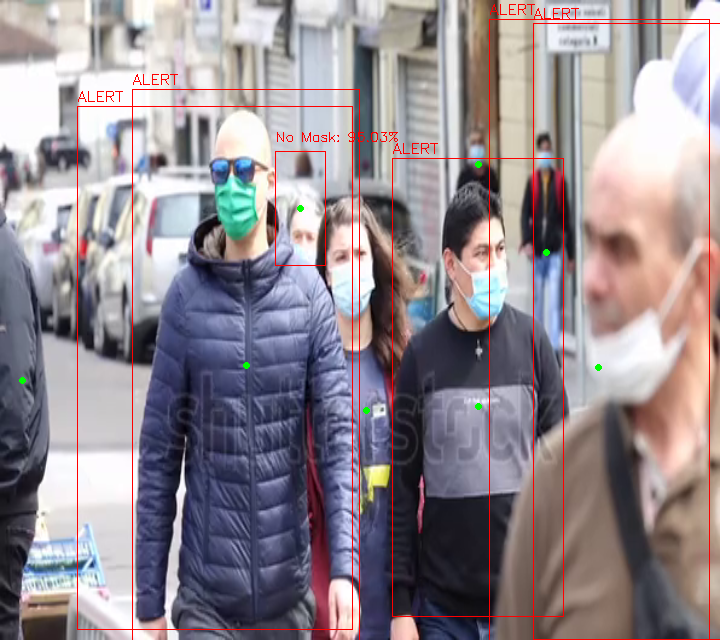

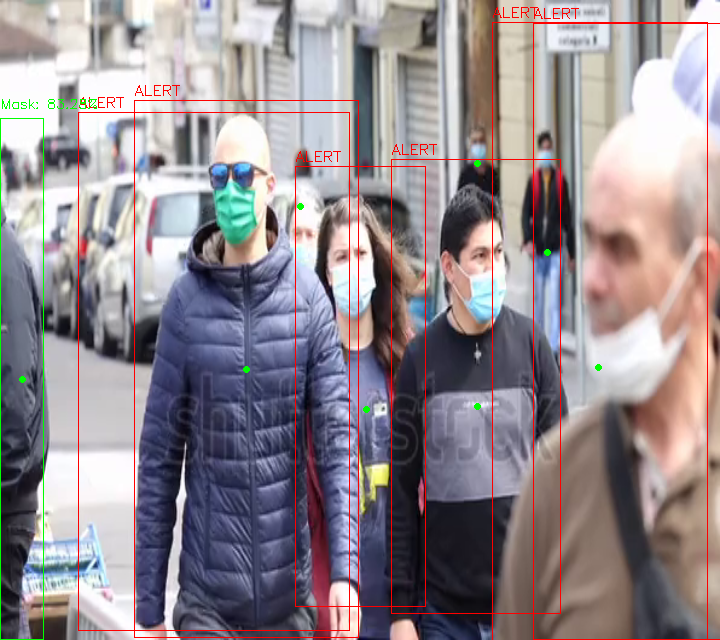

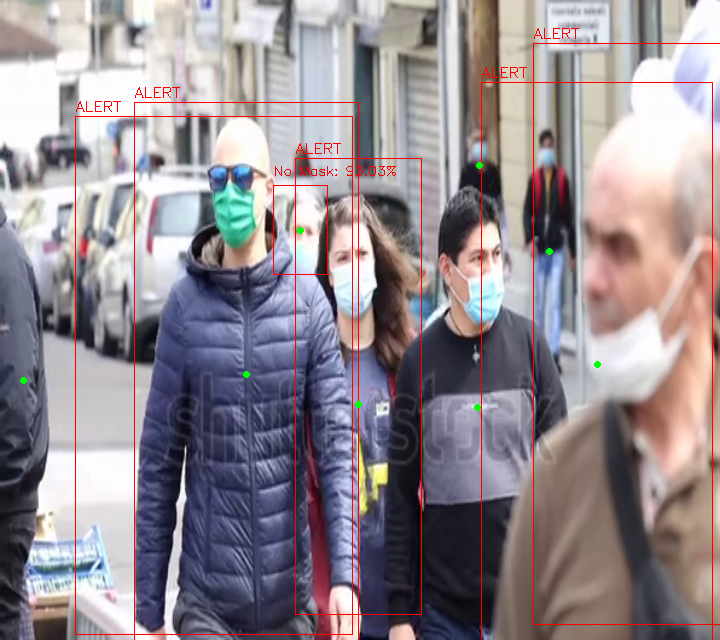

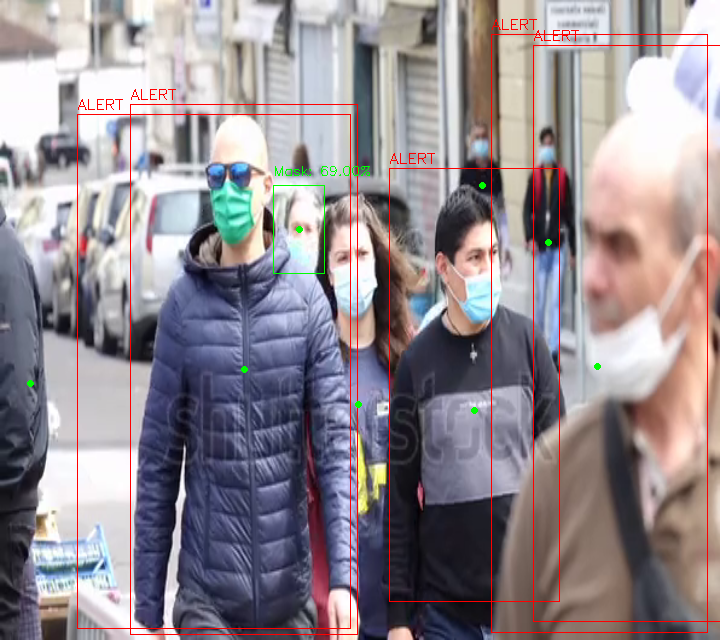

...

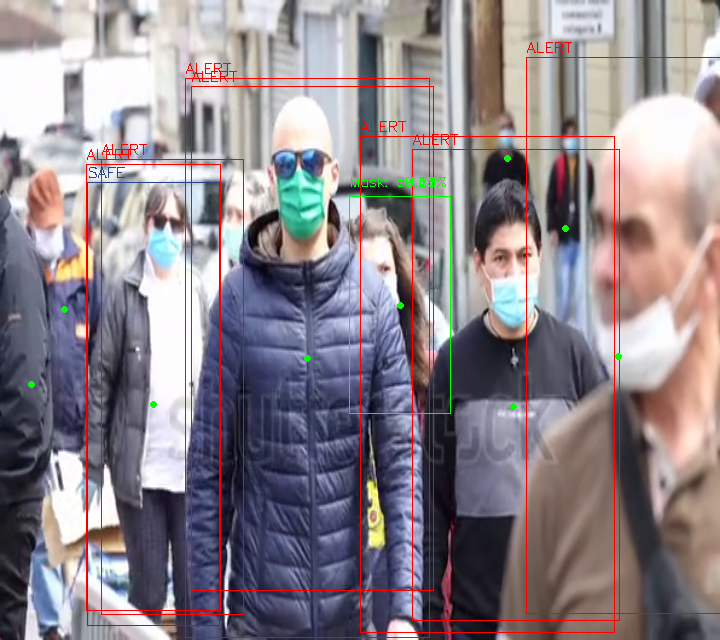

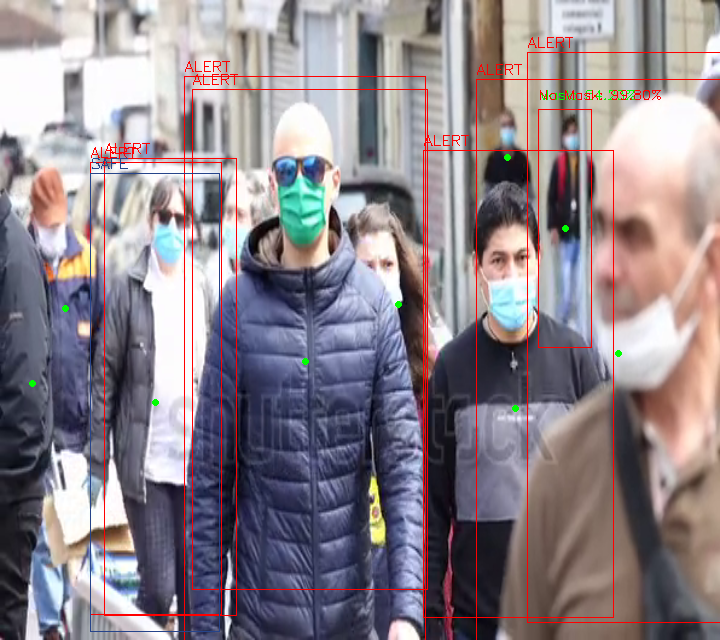

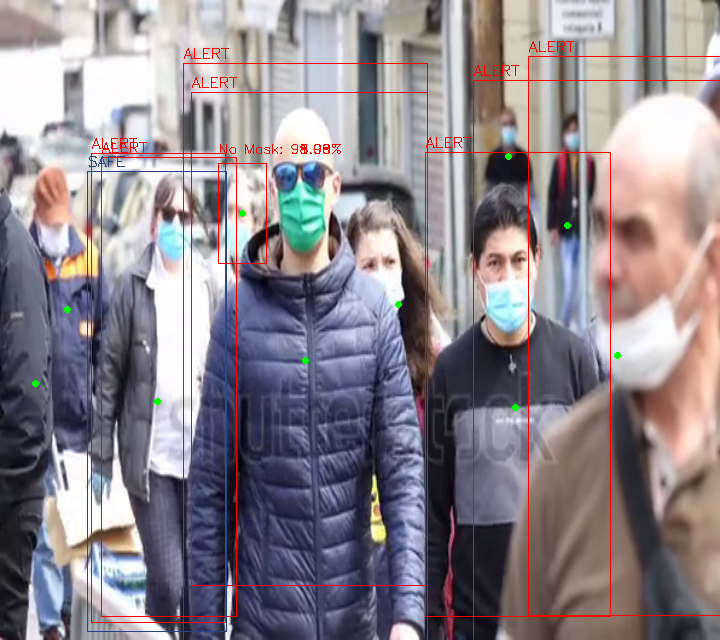

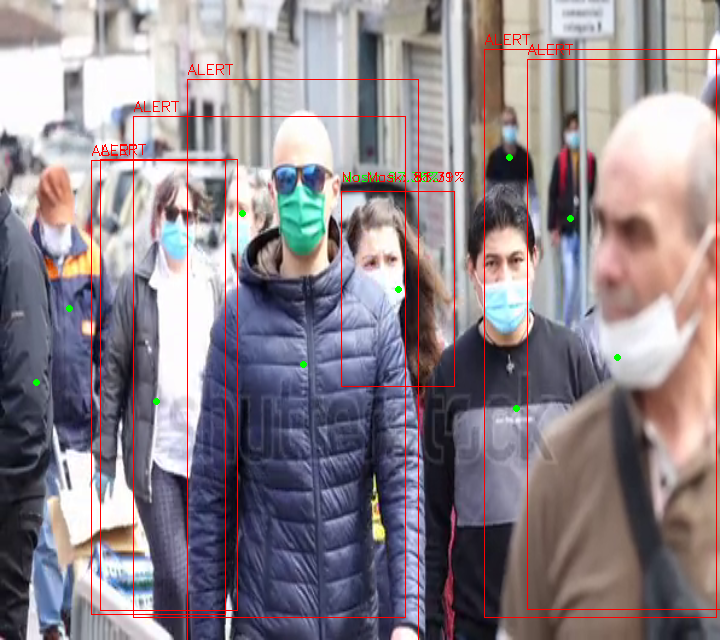

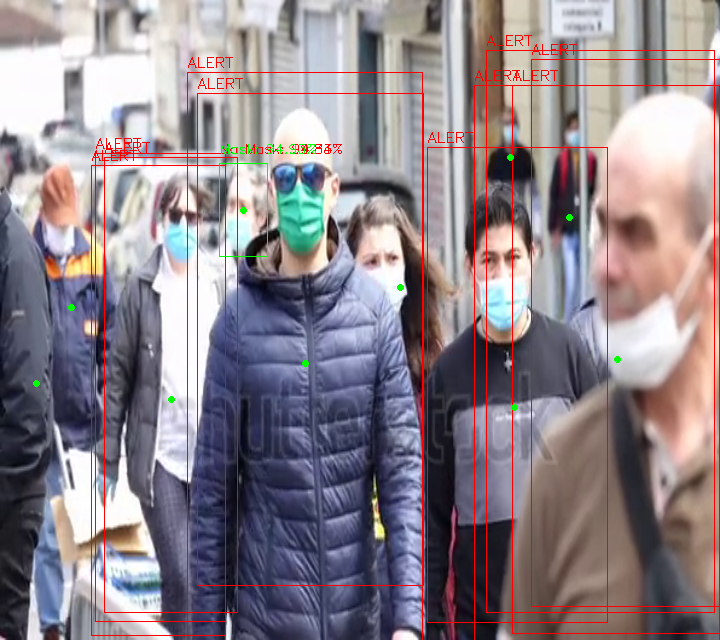

In [ ]:
import numpy as np
import imutils
import time
import cv2
import math
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.models import load_model
from scipy.spatial import distance as dist
from google.colab.patches import cv2_imshow

labelsPath = "/content/drive/MyDrive/project/yolo-coco/coco.names"
LABELS = open(labelsPath).read().strip().split("\n")
np.random.seed(42)
# COLORS = np.random.randint(0, 255, size=(len(LABELS), 3), dtype="uint8")

weightsPath = "/content/drive/MyDrive/project/yolo-coco/yolov3.weights"
configPath = "/content/drive/MyDrive/project/yolo-coco/yolov3.cfg"

net = cv2.dnn.readNetFromDarknet(configPath, weightsPath)

if USE_GPU:
	print("Searching for GPU")
	net.setPreferableBackend(cv2.dnn.DNN_BACKEND_CUDA)
	net.setPreferableTarget(cv2.dnn.DNN_TARGET_CUDA)

prototxtPath = "/content/drive/MyDrive/project/models/deploy.prototxt"
weightsPath = "/content/drive/MyDrive/project/models/res10_300x300_ssd_iter_140000.caffemodel"
faceNet = cv2.dnn.readNet(prototxtPath, weightsPath)

model_store_dir= "/content/drive/MyDrive/project/models/classifier.model"
maskNet = load_model(model_store_dir)

confidence_threshold = 0.4
#capture = cv2.VideoCapture("https://www.bcbs.com/sites/default/files/styles/grid_horizontal_card_m/public/2020-10/Mask%20Roundup%20Image_0.png?h=b3660f0d&itok=qTr-rYSB") 
#capture = cv2.VideoCapture("https://image.shutterstock.com/image-photo/smiling-bearded-young-male-model-600w-788313199.jpg")
#capture = cv2.VideoCapture("https://image.shutterstock.com/image-photo/people-wear-protective-face-masks-600w-1814008820.jpg") 
capture = cv2.VideoCapture("/content/drive/MyDrive/project/WhatsApp Video 2021-03-23 at 9.55.30 PM.mp4") 

while (capture.isOpened()):
    ret, image = capture.read()
    
    if ret == False:
        break

    image = cv2.resize(image, (720, 640))

    (H, W) = image.shape[:2]
    ln = net.getLayerNames()
    ln = [ln[i[0] - 1] for i in net.getUnconnectedOutLayers()]
    blob = cv2.dnn.blobFromImage(image, 1/255.0, (416, 416), swapRB=True, crop=False)

    results = detect_people(image, net, ln, personId=LABELS.index("person"))  

    net.setInput(blob)
    layerOutputs = net.forward(ln)
    boxes = []
    confidences = []
    classIDs = []

    for output in layerOutputs:
        for detection in output:
            scores = detection[5:]
            classID = np.argmax(scores)
            confidence = scores[classID]
            if confidence > 0.1 and classID == 0:
                box = detection[0:4] * np.array([W, H, W, H])
                (X_center, Y_center, width, height) = box.astype("int")
                x = int(X_center - (width / 2))
                y = int(Y_center - (height / 2))
                boxes.append([x, y, int(width), int(height)])
                confidences.append(float(confidence))
                classIDs.append(classID)

    id = cv2.dnn.NMSBoxes(boxes, confidences, 0.5, 0.3)
    ind = []
    for i in range(0, len(classIDs)):
        if (classIDs[i] == 0):
            ind.append(i)

    a = []
    b = []
    if len(id) > 0:
        for i in id.flatten():
            (x, y) = (boxes[i][0], boxes[i][1])
            (w, h) = (boxes[i][2], boxes[i][3])
            a.append(x)
            b.append(y)

    distance = []
    nsd = []
    for i in range(0, len(a) - 1):
        for k in range(1, len(a)):
            if (k == i):
                break
            else:
                x_dist = (a[k] - a[i])
                y_dist = (b[k] - b[i])
                d = math.sqrt(x_dist * x_dist + y_dist * y_dist)
                distance.append(d)
                if (d <= 100.0):
                    nsd.append(i)
                    nsd.append(k)
                nsd = list(dict.fromkeys(nsd))

    color = (0, 0, 255)
    for i in nsd:
        (x, y) = (boxes[i][0], boxes[i][1])
        (w, h) = (boxes[i][2], boxes[i][3])
        cv2.rectangle(image, (x, y), (x + w, y + h), color, 1)
        text = "ALERT"
        cv2.putText(image, text, (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 1)

    color = (138, 68, 38)
    if len(id) > 0:
        for i in id.flatten():
            if (i in nsd):
                break
            else:
                (x, y) = (boxes[i][0], boxes[i][1])
                (w, h) = (boxes[i][2], boxes[i][3])
                cv2.rectangle(image, (x, y), (x + w, y + h), color, 1)
                text = "SAFE"
                cv2.putText(image, text, (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 1)



    (h, w) = image.shape[:2]
    blob = cv2.dnn.blobFromImage(image, 1.0, (416, 416), (104.0, 177.0, 123.0))

    faceNet.setInput(blob)
    detections = faceNet.forward()

    for i in range(0, detections.shape[2]):
        confidence =detections[0, 0, i, 2]

        if confidence > confidence_threshold:
            box = detections[0, 0, i, 3:7] * np.array([w, h, w, h])
            (X_start, Y_start, X_end, Y_end) = box.astype("int")

            (X_start, Y_start) = (max(0, X_start), max(0, Y_start))
            (X_end, Y_end) = (min(w - 1, X_end), min(h - 1, Y_end))

            face = image[Y_start:Y_end, X_start:X_end]
            face = cv2.cvtColor(face, cv2.COLOR_BGR2RGB)
            face = cv2.resize(face, (224, 224))
            face = img_to_array(face)
            face = preprocess_input(face)
            face = np.expand_dims(face, axis=0)

            serious = set()
            abnormal = set()

            if len(results) >= 2:
                centroids = np.array([r[2] for r in results])
                D = dist.cdist(centroids, centroids, metric="euclidean")

                for i in range(0, D.shape[0]):
                    for j in range(i + 1, D.shape[1]):
                        if D[i, j] < 50:
                            serious.add(i)
                            serious.add(j)

                        if (D[i, j] < 80) and not serious:
                            abnormal.add(i)
                            abnormal.add(j)

            for (i, (prob, bbox, centroid)) in enumerate(results):
                (X_start, Y_start, X_end, Y_end) = bbox
                (cX, cY) = centroid
                color = (0, 255, 0)
                if i in serious:
                    color = (0, 0, 255)
                elif i in abnormal:
                    color = (0, 255, 255)
                cv2.circle(image, (cX, cY), 2, color, 2)


            (mask, without_mask) = maskNet.predict(face)[0]
            label = "Mask" if mask > without_mask else "No Mask"
            color = (0, 255, 0) if label == "Mask" else (0, 0, 255)

            label = "{}: {:.2f}%".format(label, max(mask, without_mask) * 100)
            c = cv2.putText(image, label, (X_start, Y_start - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.45, color, 1)
            x = cv2.rectangle(image, (X_start, Y_start), (X_end, Y_end), color, 1)

    cv2_imshow(image) 
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

capture.release()
cv2.destroyAllWindows()

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install opencv-python==4.5.1.48 

     |████████████████████████████████| 50.4MB 61kB/s 
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: opencv-python 4.1.2.30
    Uninstalling opencv-python-4.1.2.30:
      Successfully uninstalled opencv-python-4.1.2.30
